# Assignment-8 Apply Decision Trees on Donors Choose dataset

In [1]:
import warnings
warnings.filterwarnings("ignore")
import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer
import re
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle
from tqdm import tqdm
import os
from chart_studio.plotly import plotly
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter

## 1.1 Loading Data

In [2]:
data = pd.read_csv('preprocessed_data.csv', nrows=50000)
data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,project_submitted_datetime,project_grade_category,project_title,project_essay_1,project_essay_2,...,quantity,Numerical digits in summary,titles_sw,essays_sw,preprocessed_project_grade_category,preprocessed_essays,preprocessed_titles,sentimental_score,preprocessed_essay_word_count,preprocessed_title_word_count
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,Mrs.,IN,2016-12-05 13:43:57,Grades PreK-2,Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",...,23,0,educational support english learners home,my students english learners working english s...,grades_prek_2,students english learners working english seco...,educational support english learners home,0.9735,147,5
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,Mr.,FL,2016-10-25 09:22:10,Grades 6-8,Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,...,1,0,wanted projector hungry learners,our students arrive school eager learn they po...,grades_6_8,students arrive school eager learn polite gene...,wanted projector hungry learners,0.9856,97,4


In [3]:
data['project_is_approved'].value_counts()

1    42286
0     7714
Name: project_is_approved, dtype: int64

In [4]:
y = data['project_is_approved'].values
X = data.drop(['project_is_approved'], axis=1)
X.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,project_submitted_datetime,project_grade_category,project_title,project_essay_1,project_essay_2,...,quantity,Numerical digits in summary,titles_sw,essays_sw,preprocessed_project_grade_category,preprocessed_essays,preprocessed_titles,sentimental_score,preprocessed_essay_word_count,preprocessed_title_word_count
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,Mrs.,IN,2016-12-05 13:43:57,Grades PreK-2,Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",...,23,0,educational support english learners home,my students english learners working english s...,grades_prek_2,students english learners working english seco...,educational support english learners home,0.9735,147,5
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,Mr.,FL,2016-10-25 09:22:10,Grades 6-8,Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,...,1,0,wanted projector hungry learners,our students arrive school eager learn they po...,grades_6_8,students arrive school eager learn polite gene...,wanted projector hungry learners,0.9856,97,4


## 1.2 Splitting data into Train and cross validation(or test): Stratified Sampling

In [5]:
# train test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y)

## 1.3 Make Data Model Ready: encoding essay, and project_title

### 1.3.1 Vectorizing preprocessed essays & project_title using BOW

In [93]:
# preprocessed essays
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

print("="*100)


vectorizer = CountVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer.fit(X_train['preprocessed_essays'].values)  # fit has to happen only on train data

# we use the fit CountVectorizer to convert the text to vector
X_train_essay_bow = vectorizer.transform(X_train['preprocessed_essays'].values)
X_test_essay_bow = vectorizer.transform(X_test['preprocessed_essays'].values)

(33500, 28) (33500,)
(16500, 28) (16500,)


In [95]:
f1=vectorizer.get_feature_names()
print("After vectorization")
print(X_train_essay_bow.shape, y_train.shape)
print(X_test_essay_bow.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 5000) (33500,)
(16500, 5000) (16500,)


In [96]:
#project_title
vectorizer = CountVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer.fit(X_train['preprocessed_titles'].values.astype('U'))

X_train_title_bow = vectorizer.transform(X_train['preprocessed_titles'].values.astype('U'))
X_test_title_bow = vectorizer.transform(X_test['preprocessed_titles'].values.astype('U'))

In [97]:
f2=vectorizer.get_feature_names()
print("After vectorization")
print(X_train_title_bow.shape, y_train.shape)
print(X_test_title_bow.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 2346) (33500,)
(16500, 2346) (16500,)


### 1.3.2 Vectorizing preprocessed essays & project_title using TFIDF

In [98]:
#TFIDF for preprocessed_essays
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer.fit(X_train['preprocessed_essays'].values)

X_train_essay_tfidf = vectorizer.transform(X_train['preprocessed_essays'].values)
X_test_essay_tfidf = vectorizer.transform(X_test['preprocessed_essays'].values)

In [99]:
f3=vectorizer.get_feature_names()
print("After vectorization")
print(X_train_essay_tfidf.shape, y_train.shape)
print(X_test_essay_tfidf.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 5000) (33500,)
(16500, 5000) (16500,)


In [100]:
#TFIDF for preprocessed_titles
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer.fit(X_train['preprocessed_titles'].values.astype('U'))

X_train_titles_tfidf = vectorizer.transform(X_train['preprocessed_titles'].values.astype('U'))
X_test_titles_tfidf = vectorizer.transform(X_test['preprocessed_titles'].values.astype('U'))

In [101]:
f4=vectorizer.get_feature_names()
print("After vectorization")
print(X_train_titles_tfidf.shape, y_train.shape)
print(X_test_titles_tfidf.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 2346) (33500,)
(16500, 2346) (16500,)


### 1.3.3 Vectorizing preprocessed essays & project_title using Avg W2V

#### 1.3.3.1 For preprocessed_titles

In [18]:
#Avg W2V for preprocessed_titles
#Train your own Word2Vec model using your own text corpus
import warnings
warnings.filterwarnings("ignore")
#train data
w2v_data= X_train['preprocessed_titles']
split_title_train=[]
for row in w2v_data: 
    split_title_train.append([word for word in str(row).split()])     #splitting words

#train your W2v
train_w2v = Word2Vec(split_title_train,min_count=1,size=50, workers=4)
word_vectors_train = train_w2v.wv
w2v_words_train =list(word_vectors_train.vocab)
print(len(w2v_words_train ))

9605


In [19]:
# compute average word2vec for each title.
sent_vectors_train = [] # the avg-w2v for each title is stored in this list
for sent in tqdm(split_title_train):   # for each title
    sent_vec = np.zeros(50)  # as word vectors are of zero length 50
    cnt_words =0   # num of words with a valid vector in the title
    for word in sent:   # for each word in a title
        if word in w2v_words_train:
            vec = word_vectors_train[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
        sent_vectors_train.append(sent_vec)
print(len(sent_vectors_train))
print(len(sent_vectors_train[3]))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33500/33500 [00:04<00:00, 7374.08it/s]


33500
50


In [20]:
# For test data

# compute average word2vec for each title.
sent_vectors_test = [] # the avg-w2v for each title is stored in this list
for sent in tqdm(X_test['preprocessed_titles']):   # for each title
    sent_vec = np.zeros(50)  # as word vectors are of zero length 50
    #cnt_words =0   # num of words with a valid vector in the title
    for word in str(sent):   # for each word in a title
        if word in w2v_words_train:
            vec = word_vectors_train[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
        sent_vectors_test.append(sent_vec)
print(len(sent_vectors_test))
print(len(sent_vectors_test[3]))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16500/16500 [00:55<00:00, 297.89it/s]


16500
50


#### 1.3.3.2 For preprocessed_essays

##### Using Pretrained Models: Avg W2V

In [22]:
# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/
# make sure you have the glove_vectors file
with open('C:\\Users\\Admin\\Assignments and case studies\\Mandatory\\Assignment 7-SVM on donors choose\\glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())
print ("Done.",len(model)," words loaded!")

Done. 51510  words loaded!


In [23]:
# Avg W2V for train data
# compute average word2vec for each review.
avg_w2v_essay_train = []   # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_train['preprocessed_essays']):   # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0 # num of words with a valid vector in the sentence/review
    for word in sentence.split():  # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    avg_w2v_essay_train.append(vector)
print(len(avg_w2v_essay_train))
print(len(avg_w2v_essay_train[0]))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33500/33500 [00:13<00:00, 2397.72it/s]


33500
300


In [24]:
# Avg W2V for test data

avg_w2v_essay_test = []   # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_test['preprocessed_essays']):   # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0 # num of words with a valid vector in the sentence/review
    for word in sentence.split():  # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    avg_w2v_essay_test.append(vector)
print(len(avg_w2v_essay_test))
print(len(avg_w2v_essay_test[0]))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16500/16500 [00:06<00:00, 2378.12it/s]


16500
300


### 1.3.4 Vectorizing preprocessed essays & project_title using TFIDF weighted W2V

#### 1.3.4.1 For preprocessed essays

In [25]:
# For train data

tfidf_model = TfidfVectorizer()
tfidf_model.fit(X_train['preprocessed_essays']) 
#we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words_essays = set(tfidf_model.get_feature_names())

In [26]:
# average Word2Vec using pretrained models
# compute average word2vec for each review.
tfidf_w2v_train_essay = [] # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_train['preprocessed_essays']): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words_essays):
            vec = model[word]  # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
        tfidf_w2v_train_essay.append(vector)
print(len(tfidf_w2v_train_essay))
print(len(tfidf_w2v_train_essay[0]))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33500/33500 [01:31<00:00, 366.50it/s]


33500
300


In [27]:
# For test data

tfidf_w2v_test_essay = [] # the avg-w2v for each sentence/review is stored in this list
for sentence2 in tqdm(X_test['preprocessed_essays']): # for each review/sentence
    vector2 = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight2 =0; # num of words with a valid vector in the sentence/review
    for word2 in sentence2.split(): # for each word in a review/sentence
        if (word2 in glove_words) and (word2 in tfidf_words_essays):
            vec2 = model[word2]  # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf2 = dictionary[word2]*(sentence2.count(word2)/len(sentence2.split())) # getting the tfidf value for each word
            vector2 += (vec2 * tf_idf2) # calculating tfidf weighted w2v
            tf_idf_weight2 += tf_idf2
    if tf_idf_weight2 != 0:
        vector2 /= tf_idf_weight2
        tfidf_w2v_test_essay.append(vector2)
print(len(tfidf_w2v_test_essay))
print(len(tfidf_w2v_test_essay[0]))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16500/16500 [00:48<00:00, 342.12it/s]


16500
300


#### 1.3.4.2 For preprocessed titles

#### Using pretrained models

In [28]:
# For train data

tfidf_model1 = TfidfVectorizer()
tfidf_model1.fit(X_train['preprocessed_titles'].values.astype('U'))
#we are converting a dictionary with word as a key, and the idf as a value
dictionary_title = dict(zip(tfidf_model1.get_feature_names(), list(tfidf_model1.idf_)))
tfidf_words_titles = set(tfidf_model1.get_feature_names())

In [30]:
# average Word2Vec using pretrained models
# compute average word2vec for each review.
tfidf_w2v_train_title = [] # the avg-w2v for each sentence/review is stored in this list
for sentence_title in tqdm(X_train['preprocessed_titles']): # for each review/sentence
    vector3 = np.zeros(300) # as word vectors are of zero length
    #tf_idf_weight3=0; # num of words with a valid vector in the sentence/review
    for word3 in str(sentence_title).split(): # for each word in a review/sentence
        if (word3 in glove_words) and (word3 in tfidf_words_titles):
            vec4 = model[word3]  # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf3 = dictionary_title[word3]*(sentence_title.count(word3)/len(str(sentence_title).split())) # getting the tfidf value for each word
            vector3 += (vec4 * tf_idf3) # calculating tfidf weighted w2v
            tf_idf_weight3 += tf_idf3
    if tf_idf_weight3 != 0:
        vector3 /= tf_idf_weight3
        tfidf_w2v_train_title.append(vector3)
print(len(tfidf_w2v_train_title))
print(len(tfidf_w2v_train_title[0]))

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33500/33500 [00:01<00:00, 20163.31it/s]


33500
300


In [32]:
# For test data
tfidf_w2v_test_title = [] # the avg-w2v for each sentence/review is stored in this list
for sentence_test in tqdm(X_test['preprocessed_titles']): # for each review/sentence
    vector5 = np.zeros(300) # as word vectors are of zero length
    #tf_idf_weight5 =0; # num of words with a valid vector in the sentence/review
    for word5 in str(sentence_test).split(): # for each word in a review/sentence
        if (word5 in glove_words) and (word5 in tfidf_words_titles):
            vec6 = model[word5]  # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf5 = dictionary_title[word5]*(sentence_test.count(word5)/len(str(sentence_test).split())) # getting the tfidf value for each word
            vector5 += (vec6 * tf_idf5) # calculating tfidf weighted w2v
            tf_idf_weight5 += tf_idf5
    if tf_idf_weight5 != 0:    
        vector5 /= tf_idf_weight5
        tfidf_w2v_test_title.append(vector5)
print(len(tfidf_w2v_test_title))
print(len(tfidf_w2v_test_title[0]))

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16500/16500 [00:00<00:00, 20538.88it/s]


16500
300


## 1.4 Make Data Model Ready: encoding numerical, categorical features

### 1.4.1 Encoding categorical features: School State

In [102]:
vectorizer = CountVectorizer()
vectorizer.fit(X_train['school_state'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_state = vectorizer.transform(X_train['school_state'].values)
X_test_state = vectorizer.transform(X_test['school_state'].values)
f5=vectorizer.get_feature_names()
print("After vectorizations")
print(X_train_state.shape, y_train.shape)
print(X_test_state.shape, y_test.shape)
print(f5)
print("="*100)

After vectorizations
(33500, 51) (33500,)
(16500, 51) (16500,)
['ak', 'al', 'ar', 'az', 'ca', 'co', 'ct', 'dc', 'de', 'fl', 'ga', 'hi', 'ia', 'id', 'il', 'in', 'ks', 'ky', 'la', 'ma', 'md', 'me', 'mi', 'mn', 'mo', 'ms', 'mt', 'nc', 'nd', 'ne', 'nh', 'nj', 'nm', 'nv', 'ny', 'oh', 'ok', 'or', 'pa', 'ri', 'sc', 'sd', 'tn', 'tx', 'ut', 'va', 'vt', 'wa', 'wi', 'wv', 'wy']


### 1.4.2 Encoding categorical features: teacher_prefix

In [103]:
vectorizer = CountVectorizer()
vectorizer.fit(X_train['teacher_prefix'].values) 

X_train_teacher = vectorizer.transform(X_train['teacher_prefix'].values)
X_test_teacher = vectorizer.transform(X_test['teacher_prefix'].values)

f6=vectorizer.get_feature_names()
print("After vectorizations")
print(X_train_teacher.shape, y_train.shape)
print(X_test_teacher.shape, y_test.shape)
print(f6)
print("="*100)

After vectorizations
(33500, 6) (33500,)
(16500, 6) (16500,)
['dr', 'mr', 'mrs', 'ms', 'none', 'teacher']


### 1.4.3 Encoding categorical features: project_grade_category

In [104]:
#This step is to intialize a vectorizer with vocab from train data
#Ref: https://www.kaggle.com/shashank49/donors-choose-knn#Concatinating-all-features-(TFIDF)
from collections import Counter
my_counter = Counter()
for word in X_train['project_grade_category'].values:
    my_counter.update([word[i:i+14] for i in range(0, len(word),14)]) #https://www.geeksforgeeks.org/python-string-split/

# dict sort by value python: https://stackoverflow.com/a/613218/4084039
project_grade_category_dict = dict(my_counter)
sorted_project_grade_category_dict = dict(sorted(project_grade_category_dict.items(), key=lambda kv: kv[1]))

In [105]:
vectorizer = CountVectorizer(vocabulary=list(sorted_project_grade_category_dict.keys()), lowercase=False, binary=True,max_features=4)
vectorizer.fit(X_train['project_grade_category'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_grade = vectorizer.transform(X_train['project_grade_category'].values)
X_test_grade = vectorizer.transform(X_test['project_grade_category'].values)

f7=vectorizer.get_feature_names()
print("After vectorizations")
print(X_train_grade.shape, y_train.shape)
print(X_test_grade.shape, y_test.shape)
print(f7)

After vectorizations
(33500, 4) (33500,)
(16500, 4) (16500,)
['Grades 9-12', 'Grades 6-8', 'Grades 3-5', 'Grades PreK-2']


### 1.4.4 Encoding categorical features: clean_categories

In [106]:
vectorizer = CountVectorizer()
vectorizer.fit(X_train['clean_categories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_cat = vectorizer.transform(X_train['clean_categories'].values)
X_test_cat = vectorizer.transform(X_test['clean_categories'].values)

f8=vectorizer.get_feature_names()
print("After vectorizations")
print(X_train_cat.shape, y_train.shape)
print(X_test_cat.shape, y_test.shape)
print(f8)
print("="*100)

After vectorizations
(33500, 9) (33500,)
(16500, 9) (16500,)
['appliedlearning', 'care_hunger', 'health_sports', 'history_civics', 'literacy_language', 'math_science', 'music_arts', 'specialneeds', 'warmth']


### 1.4.5 Encoding categorical features: clean_subcategories

In [107]:
vectorizer = CountVectorizer()
vectorizer.fit(X_train['clean_subcategories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_subcat = vectorizer.transform(X_train['clean_subcategories'].values)
X_test_subcat = vectorizer.transform(X_test['clean_subcategories'].values)

f9=vectorizer.get_feature_names()
print("After vectorizations")
print(X_train_subcat.shape, y_train.shape)
print(X_test_subcat.shape, y_test.shape)
print(f9)
print("="*100)

After vectorizations
(33500, 30) (33500,)
(16500, 30) (16500,)
['appliedsciences', 'care_hunger', 'charactereducation', 'civics_government', 'college_careerprep', 'communityservice', 'earlydevelopment', 'economics', 'environmentalscience', 'esl', 'extracurricular', 'financialliteracy', 'foreignlanguages', 'gym_fitness', 'health_lifescience', 'health_wellness', 'history_geography', 'literacy', 'literature_writing', 'mathematics', 'music', 'nutritioneducation', 'other', 'parentinvolvement', 'performingarts', 'socialsciences', 'specialneeds', 'teamsports', 'visualarts', 'warmth']


### 1.4.6 Encoding numerical features: Price

In [109]:
from sklearn.preprocessing import Normalizer
normalizer1 = Normalizer() 
# normalizer.fit(X_train['price'].values)
#this will rise an error Expected 2D array, got 1D array instead:
normalizer1.fit(X_train['price'].values.reshape(-1,1))

X_train_price_norm = normalizer1.transform(X_train['price'].values.reshape(-1,1))
X_test_price_norm = normalizer1.transform(X_test['price'].values.reshape(-1,1))

print("After vectorizations")
print(X_train_price_norm.shape, y_train.shape)
print(X_test_price_norm.shape, y_test.shape)
print("="*100)

After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.7 Encoding numerical features: Quantity

In [41]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer() 
normalizer.fit(X_train['quantity'].values.reshape(1,-1))

X_train_quantity_norm = normalizer.transform(X_train['quantity'].values.reshape(1,-1))
X_test_quantity_norm = normalizer.transform(X_test['quantity'].values.reshape(1,-1))

print("After vectorizations")
print(X_train_quantity_norm.shape, y_train.shape)
print(X_test_quantity_norm.shape, y_test.shape)
print("="*100)

After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.8 Encoding numerical features: teacher_number_of_previously_posted_projects

In [42]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
normalizer.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

X_train_projects_norm = normalizer.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))
X_test_projects_norm = normalizer.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(1,-1))

print("After vectorizations")
print(X_train_projects_norm.shape, y_train.shape)
print(X_test_projects_norm.shape, y_test.shape)
print("="*100)

After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.9 Encoding numerical features: sentimental_score

In [43]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer() 
normalizer.fit(X_train['sentimental_score'].values.reshape(-1,1))

X_train_senti_norm = normalizer.transform(X_train['sentimental_score'].values.reshape(1,-1))
X_test_senti_norm = normalizer.transform(X_test['sentimental_score'].values.reshape(1,-1))

print("After vectorizations")
print(X_train_senti_norm.shape, y_train.shape)
print(X_test_senti_norm.shape, y_test.shape)
print("="*100)

After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.10 Encoding numerical features: preprocessed_essay_word_count

In [44]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer() 
normalizer.fit(X_train['preprocessed_essay_word_count'].values.reshape(-1,1))

X_train_ewc_norm = normalizer.transform(X_train['preprocessed_essay_word_count'].values.reshape(1,-1))
X_test_ewc_norm = normalizer.transform(X_test['preprocessed_essay_word_count'].values.reshape(1,-1))

print("After vectorization")
print(X_train_ewc_norm.shape, y_train.shape)
print(X_test_ewc_norm.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.11 Encoding numerical features: preprocessed_title_word_count

In [45]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer() 
normalizer.fit(X_train['preprocessed_title_word_count'].values.reshape(-1,1))

X_train_twc_norm = normalizer.transform(X_train['preprocessed_title_word_count'].values.reshape(1,-1))
X_test_twc_norm = normalizer.transform(X_test['preprocessed_title_word_count'].values.reshape(1,-1))

print("After vectorization")
print(X_train_twc_norm.shape, y_train.shape)
print(X_test_twc_norm.shape, y_test.shape)
print("="*100)

After vectorization
(33500, 1) (33500,)
(16500, 1) (16500,)


### 1.4.5 Concatinating all the features

#### 1.4.5.1 Set 1: Using categorical features + numerical features + preprocessed_titles(BOW) + preprocessed_essays(BOW)

In [46]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
from scipy.sparse import hstack

X_tr_bow = hstack((X_train_essay_bow, X_train_title_bow, X_train_state, X_train_teacher, X_train_grade, X_train_cat, X_train_subcat, X_train_price_norm, X_train_quantity_norm, X_train_projects_norm )).tocsr()


X_test_bow = hstack((X_test_essay_bow, X_test_title_bow, X_test_state, X_test_teacher, X_test_grade, X_test_cat, X_test_subcat, X_test_price_norm, X_test_quantity_norm, X_test_projects_norm )).tocsr()

print("Final Data Matrix")
print(X_tr_bow.shape, y_train.shape)
print(X_test_bow.shape, y_train.shape)

Final Data Matrix
(33500, 7449) (33500,)
(16500, 7449) (33500,)


#### 1.4.5.2 Set 2: Using categorical features + numerical features + preprocessed_titles(TFIDF) + preprocessed_essays(TFIDF)

In [47]:
X_tr_tfidf = hstack((X_train_essay_tfidf, X_train_titles_tfidf, X_train_state, X_train_teacher, X_train_grade, X_train_cat, X_train_subcat, X_train_price_norm, X_train_quantity_norm, X_train_projects_norm )).tocsr()


X_test_tfidf = hstack((X_test_essay_tfidf, X_test_titles_tfidf, X_test_state, X_test_teacher, X_test_grade, X_test_cat, X_test_subcat, X_test_price_norm, X_test_quantity_norm, X_test_projects_norm )).tocsr()

print("Final Data Matrix")
print(X_tr_tfidf.shape, y_train.shape)
print(X_test_tfidf.shape, y_train.shape)

Final Data Matrix
(33500, 7449) (33500,)
(16500, 7449) (33500,)


#### 1.4.5.3 Set 3: Using categorical features + numerical features + preprocessed_titles(Avg W2V) + preprocessed_essays(Avg W2V)

In [48]:
X_tr_avgw2v = hstack((sent_vectors_train, avg_w2v_essay_train, X_train_state, X_train_teacher, X_train_grade, X_train_cat, X_train_subcat, X_train_price_norm, X_train_quantity_norm, X_train_projects_norm )).tocsr()


X_test_avgw2v = hstack((sent_vectors_test, avg_w2v_essay_test, X_test_state, X_test_teacher, X_test_grade, X_test_cat, X_test_subcat, X_test_price_norm, X_test_quantity_norm, X_test_projects_norm )).tocsr()

print("Final Data Matrix")
print(X_tr_avgw2v.shape, y_train.shape)
print(X_test_avgw2v.shape, y_train.shape)

Final Data Matrix
(33500, 453) (33500,)
(16500, 453) (33500,)


#### 1.4.5.4 Set 4: Using categorical features + numerical features + preprocessed_titles(TFIDF W2V) + preprocessed_essays(TFIDF W2V)

In [49]:
X_tr_tfidf_w2v = hstack((tfidf_w2v_train_essay, tfidf_w2v_train_title, X_train_state, X_train_teacher, X_train_grade, X_train_cat, X_train_subcat, X_train_price_norm, X_train_quantity_norm, X_train_projects_norm )).tocsr()

X_test_tfidf_w2v = hstack((tfidf_w2v_test_essay, tfidf_w2v_test_title, X_test_state, X_test_teacher, X_test_grade, X_test_cat, X_test_subcat, X_test_price_norm, X_test_quantity_norm, X_test_projects_norm )).tocsr()

print("Final Data Matrix")
print(X_tr_tfidf_w2v.shape, y_train.shape)
print(X_test_tfidf_w2v.shape, y_train.shape)

Final Data Matrix
(33500, 703) (33500,)
(16500, 703) (33500,)


## 2. Applying DT

### 2.1 Set 1: BOW featurization

#### 2.1.1 Hyper parameter tuning

In [50]:
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier

dt_bow = DecisionTreeClassifier(criterion='gini',class_weight = 'balanced') #https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
parameters = {'max_depth': [4, 6, 8, 10, 30], 'min_samples_split': [5, 20, 80, 200, 500]}
clf1 = RandomizedSearchCV(dt_bow, parameters, cv=3, scoring='roc_auc',return_train_score=True,n_jobs=-1)
rs1 = clf1.fit(X_tr_bow, y_train)

In [68]:
df=pd.DataFrame(clf1.cv_results_)
df.head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,1.021475,0.039561,0.038473,0.021746,500,6,"{'min_samples_split': 500, 'max_depth': 6}",0.612301,0.615899,0.610337,0.612846,0.002303,2,0.634982,0.637195,0.648638,0.640272,0.005984
1,1.111778,0.022664,0.020260,0.002591,200,6,"{'min_samples_split': 200, 'max_depth': 6}",0.610980,0.615522,0.609308,0.611937,0.002625,4,0.641815,0.641343,0.652279,0.645146,0.005048
2,0.589626,0.002974,0.033230,0.016582,500,4,"{'min_samples_split': 500, 'max_depth': 4}",0.583552,0.604492,0.586551,0.591532,0.009246,8,0.597360,0.605926,0.608983,0.604090,0.004920
3,5.679940,0.595381,0.025874,0.002980,500,30,"{'min_samples_split': 500, 'max_depth': 30}",0.605353,0.593378,0.603195,0.600642,0.005212,7,0.761538,0.784940,0.787975,0.778151,0.011813
4,1.556769,0.181293,0.024326,0.002045,500,8,"{'min_samples_split': 500, 'max_depth': 8}",0.617950,0.613621,0.611641,0.614404,0.002634,1,0.655795,0.658222,0.670510,0.661509,0.006441


#### 2.1.2 3D-Plot

In [63]:
%matplotlib inline
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
import numpy as np

In [65]:
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)

In [67]:
# https://plot.ly/python/3d-axes/
trace1 = go.Scatter3d(x=df['param_min_samples_split'],y=df['param_max_depth'],z=df['mean_train_score'], name = 'train')
trace2 = go.Scatter3d(x=df['param_min_samples_split'],y=df['param_max_depth'],z=df['mean_test_score'], name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='Min_samples'),
        yaxis = dict(title='Max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

#### 2.1.3 Best Hyperparameters

In [310]:
print(clf1.best_estimator_)
print(f'CV score on train data {clf1.score(X_tr_bow,y_train)}')
print(f'Mean cross-validated score of the best_estimator : {clf1.best_score_}')

DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=8,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=500,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')
CV score on train data 0.6598851476183109
Mean cross-validated score of the best_estimator : 0.6144041655799374


In [71]:
best_parameters_bow = {'max_depth': [8], 'min_samples_split': [500]}

#### 2.1.4 Applying Best Hyperparameters on train & test data & plotting ROC curve

In [89]:
def batch_predict(clf, data):
    # roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
    # not the predicted outputs
    y_data_pred = []
    pred_labels=[]
    tr_loop = data.shape[0] - data.shape[0]%1000;
    # consider you X_tr shape is 49041, then your tr_loop will be 49041 - 49041%1000 = 49000
    # in this for loop we will iterate until the last 1000 multiplier
    for i in range(0, tr_loop, 1000):
        y_data_pred.extend(clf.predict_proba(data[i:i+1000])[:,1]) # we will be predicting for the last data points
        pred_labels.extend(clf.predict(data[i:i+1000]))
    if data.shape[0]%1000 !=0:
        y_data_pred.extend(clf.predict_proba(data[tr_loop:])[:,1])
        pred_labels.extend(clf.predict(data[tr_loop:]))
            
    return y_data_pred,pred_labels

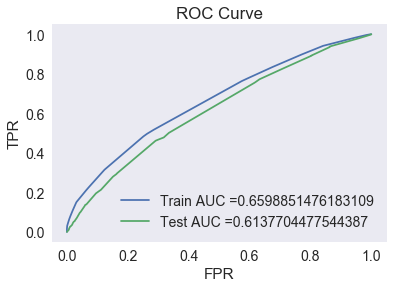

In [90]:
dt_best= DecisionTreeClassifier (class_weight = 'balanced',max_depth=8,min_samples_split=500)

dt_best.fit(X_tr_bow, y_train)

y_train_pred_bow_best,pred_labels_train = batch_predict(dt_best, X_tr_bow)
y_test_pred_bow_best,pred_labels_test = batch_predict(dt_best, X_test_bow)

train_tpr_bow, train_fpr_bow, tr_thresholds_bow = roc_curve(y_train, y_train_pred_bow_best)
test_tpr_bow, test_fpr_bow, te_thresholds_bow = roc_curve(y_test, y_test_pred_bow_best)

plt.plot(train_tpr_bow, train_fpr_bow,label="Train AUC ="+str(auc(train_tpr_bow, train_fpr_bow)))
plt.plot(test_tpr_bow, test_fpr_bow, label="Test AUC ="+str(auc(test_tpr_bow, test_fpr_bow)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve")
plt.grid()
plt.show()

#### 2.1.5 Plot confusion matrix

In [76]:
## we will pick a threshold that will give the least fpr

def find_best_threshold(threshold, fpr, tpr):
    t = threshold[np.argmax(tpr*(1-fpr))]
    # (tpr*(1-fpr)) will be maximum if your fpr is very low and tpr is very high
    print("The maximum value of tpr*(1-fpr)", max(tpr*(1-fpr)),"for threshold", np.round(t,3))
    return t

def predict_with_best_t(proba, threshold):
    predictions = []
    for i in proba:
        if i>=threshold:
            predictions.append(1)
        else:
            predictions.append(0)
    return predictions

print("="*100)

In [77]:
#function to get heatmap of confusion matrix
# Reference: https://stackoverflow.com/questions/35572000/how-can-i-plot-a-confusion-matrix

def cm_heatmap(cm):
    #y_pred = clf.predict(X_te)
    df_cm = pd.DataFrame(cm, range(2),range(2))
    df_cm.columns = ['Predicted NO','Predicted YES']
    df_cm = df_cm.rename({0: 'Actual NO', 1: 'Actual YES'})
    sns.set(font_scale=1.4)#for label size
    sns.heatmap(df_cm, annot=True,annot_kws={"size": 16}, fmt='d')

In [78]:
from sklearn.metrics import confusion_matrix
best_t_bow = find_best_threshold(tr_thresholds_bow, train_fpr_bow, train_tpr_bow)
print("Train confusion matrix")
cm_train_bow=confusion_matrix(y_train, predict_with_best_t(y_train_pred_bow_best, best_t_bow))
print(cm_train_bow)
print("Test confusion matrix")
cm_test_bow=confusion_matrix(y_test, predict_with_best_t(y_test_pred_bow_best, best_t_bow))
print(cm_test_bow)

The maximum value of tpr*(1-fpr) 0.13799869493038974 for threshold 0.481
Train confusion matrix
[[ 3690  1478]
 [13671 14661]]
Test confusion matrix
[[1693  853]
 [6961 6993]]


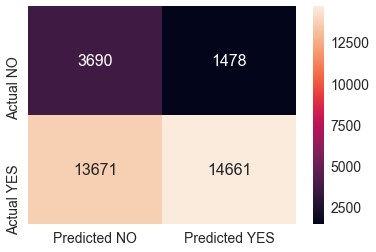

In [86]:
# confusion matrix heatmap for train data
cm_heatmap(cm_train_bow)

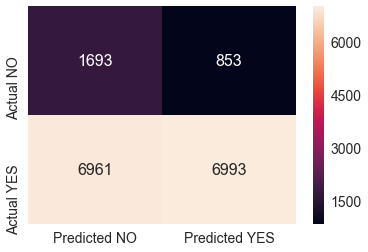

In [87]:
# confusion matrix heatmap for test data
cm_heatmap(cm_test_bow)

#### 2.1.6 Visualizing Decision tree with Graphviz

In [120]:
# Extracting all feature names from the vectorizers of respective features

BOW_feature_names= f1+f2+f5+f6+f7+f8+f9
len(BOW_feature_names)

7446

In [121]:
BOW_feature_names.append('price')         #price, quantity & previously_posted_projects are numerical features
BOW_feature_names.append('quantity')
BOW_feature_names.append('teacher_number_of_previously_posted_projects')
len(BOW_feature_names)

7449

In [266]:
import os
os.environ["PATH"] += os.pathsep + r'D:\PGS\Applied AI course\Assignments\Mandatory\graphviz'

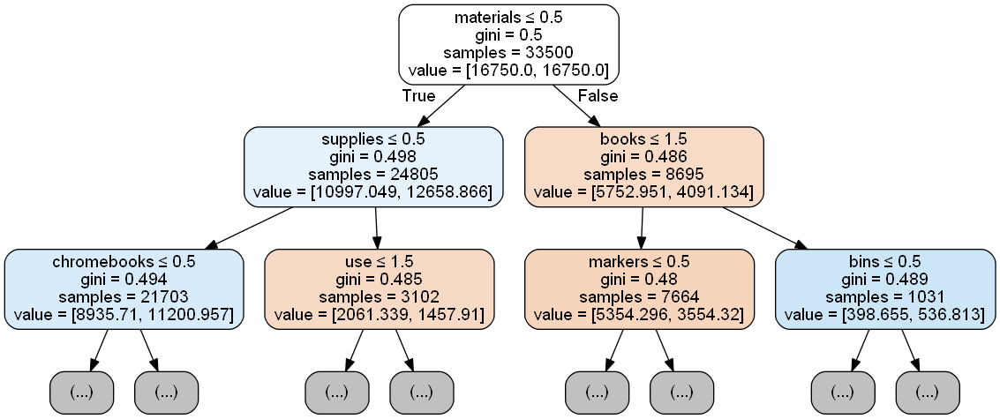

In [272]:
# Refernces:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://scikit-learn.org/stable/modules/generated/sklearn.tree.export_graphviz.html


from sklearn import tree
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO
from IPython.display import Image
import pydotplus
import collections

dot_data = StringIO()

viz1=export_graphviz(dt_best,max_depth=2, out_file=dot_data, filled=True, rounded=True,special_characters=True,feature_names=BOW_feature_names)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

#### 2.1.7 Analysis of False Positives

In [237]:
# Extracting false postives
FP_bow = []
for i in range(len(y_test)) :
    if (y_test[i] == 0) and (pred_labels_test[i] == 1) :
        FP_bow.append(i)
FP_essay_bow = []
for i in FP_bow :
    FP_essay_bow.append(X_test['preprocessed_essays'].values[i])

In [238]:
print(f'Total number of false positives = {len(FP_bow)}')

Total number of false positives = 810


### Wordcloud

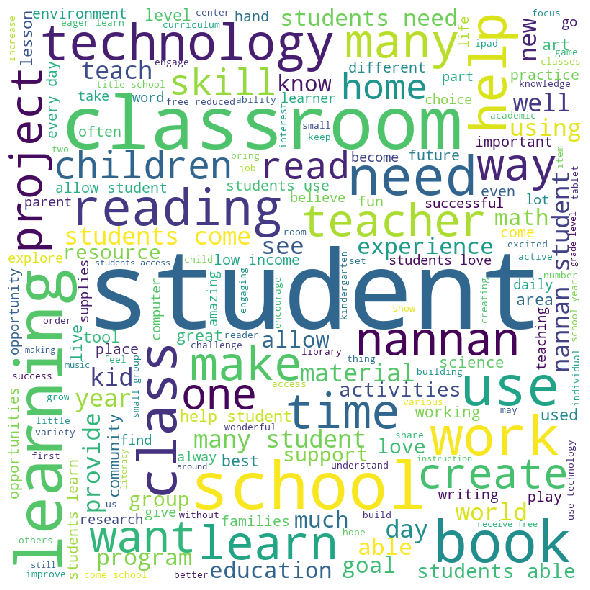

In [247]:
#plot the word cloud
#https://www.geeksforgeeks.org/generating-word-cloud-python/
from wordcloud import WordCloud

words = ' '
for row in FP_essay_bow:
    tokens = row.split()
    for t in tokens:
        words += t + ' '

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate(words)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()        


#### From the wordcloud above, it can be observed that the words " student", "classroom", "school" & "learning" had a lot of impact in predicting the class label as 1 when it was supposed to be 0.

### Box plot on Price feature for false positives

In [253]:
FP_price_bow = []
FP_projects_bow=[]
for i in FP_bow :
    FP_price_bow.append(X_test['price'].values[i])
    FP_projects_bow.append(X_test['teacher_number_of_previously_posted_projects'].values[i])

In [256]:
df_bow=pd.DataFrame(columns=['Price','Projects'])
df_bow['Price']=FP_price_bow
df_bow['Projects']=FP_projects_bow
df_bow.head()

,Price,Projects
0,133.49,0
1,199.96,1
2,359.96,3
3,187.98,2
4,283.11,0


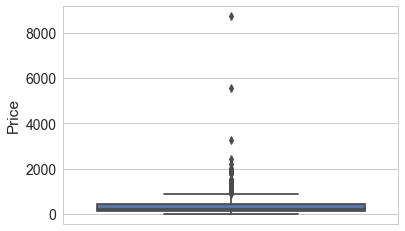

In [261]:
sns.set_style("whitegrid") 
  
sns.boxplot(y = 'Price', data = df_bow) 

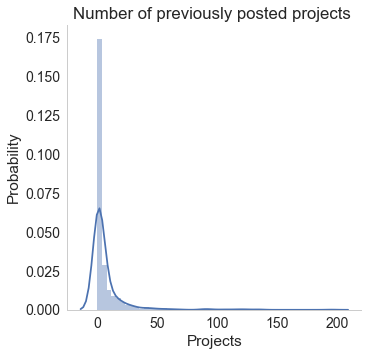

In [265]:
#pdf
import warnings 
warnings.filterwarnings("ignore")

sns.FacetGrid(df_bow,size=5) \
   .map(sns.distplot,'Projects') \
   .add_legend()
plt.ylabel('Probability')
plt.title("Number of previously posted projects ")
plt.grid()
plt.show()

### 2.2 Set 2: TFIDF featurization

#### 2.2.1 Hyper parameter tuning

In [273]:
dt_tfidf = DecisionTreeClassifier(criterion='gini',class_weight = 'balanced') #https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
parameters = {'max_depth': [4, 6, 8, 10, 30,50], 'min_samples_split': [5, 20, 80, 200, 500,800]}
clf2 = RandomizedSearchCV(dt_tfidf, parameters, cv=3, scoring='roc_auc',return_train_score=True,n_jobs=-1)
rs2 = clf2.fit(X_tr_tfidf, y_train)

In [274]:
df1=pd.DataFrame(clf2.cv_results_)
df1.head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,5.277641,0.088953,0.038977,0.002158,80,6,"{'min_samples_split': 80, 'max_depth': 6}",0.615450,0.612809,0.594634,0.607631,0.009253,4,0.651581,0.656035,0.665081,0.657566,0.005617
1,31.315708,1.662429,0.040311,0.000942,200,50,"{'min_samples_split': 200, 'max_depth': 50}",0.577939,0.574115,0.553851,0.568635,0.010569,9,0.875934,0.890609,0.910011,0.892185,0.013957
2,5.135052,0.132839,0.039645,0.003298,500,6,"{'min_samples_split': 500, 'max_depth': 6}",0.618735,0.610885,0.598489,0.609370,0.008334,3,0.644006,0.652201,0.649740,0.648649,0.003434
3,11.507400,0.764769,0.047307,0.012490,5,10,"{'min_samples_split': 5, 'max_depth': 10}",0.613914,0.597657,0.596279,0.602617,0.008008,5,0.743540,0.729260,0.747044,0.739948,0.007692
4,9.183731,0.270108,0.036313,0.001247,800,10,"{'min_samples_split': 800, 'max_depth': 10}",0.625841,0.607197,0.611891,0.614976,0.007918,1,0.686820,0.681280,0.681349,0.683150,0.002595


#### 2.2.2 3D-Plot

In [275]:
# https://plot.ly/python/3d-axes/
trace1 = go.Scatter3d(x=df1['param_min_samples_split'],y=df1['param_max_depth'],z=df1['mean_train_score'], name = 'train')
trace2 = go.Scatter3d(x=df1['param_min_samples_split'],y=df1['param_max_depth'],z=df1['mean_test_score'], name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='Min_samples'),
        yaxis = dict(title='Max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

#### 2.2.3 Best Hyperparameters

In [309]:
print(clf2.best_estimator_)
print(f'CV score on train data {clf2.score(X_tr_tfidf,y_train)}')
print(f'Mean cross-validated score of the best_estimator : {clf2.best_score_}')

DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=10,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=800,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')
CV score on train data 0.68609838946892
Mean cross-validated score of the best_estimator : 0.614976094978327


In [277]:
best_parameters_tfidf = {'max_depth': [10], 'min_samples_split': [800]}

#### 2.2.4 Applying Best Hyperparameters on train & test data & plotting ROC curve

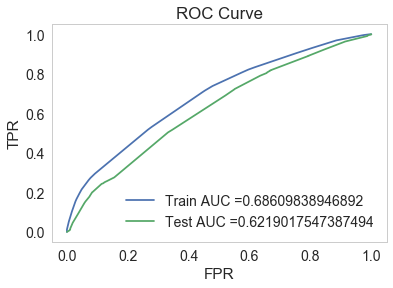

In [278]:
dt_best_tfidf= DecisionTreeClassifier (class_weight = 'balanced',max_depth=10,min_samples_split=800)

dt_best_tfidf.fit(X_tr_tfidf, y_train)

y_train_pred_tfidf_best,pred_labels_train = batch_predict(dt_best_tfidf, X_tr_tfidf)
y_test_pred_tfidf_best,pred_labels_test = batch_predict(dt_best_tfidf, X_test_tfidf)

train_tpr_tfidf, train_fpr_tfidf, tr_thresholds_tfidf = roc_curve(y_train, y_train_pred_tfidf_best)
test_tpr_tfidf, test_fpr_tfidf, te_thresholds_tfidf = roc_curve(y_test, y_test_pred_tfidf_best)

plt.plot(train_tpr_tfidf, train_fpr_tfidf,label="Train AUC ="+str(auc(train_tpr_tfidf, train_fpr_tfidf)))
plt.plot(test_tpr_tfidf, test_fpr_tfidf, label="Test AUC ="+str(auc(test_tpr_tfidf, test_fpr_tfidf)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve")
plt.grid()
plt.show()

#### 2.2.5 Plot confusion matrix

In [280]:
best_t_tfidf = find_best_threshold(tr_thresholds_tfidf, train_fpr_tfidf, train_tpr_tfidf)
print("Train confusion matrix")
cm_train_tfidf=confusion_matrix(y_train, predict_with_best_t(y_train_pred_tfidf_best, best_t_tfidf))
print(cm_train_tfidf)
print("Test confusion matrix")
cm_test_tfidf=confusion_matrix(y_test, predict_with_best_t(y_test_pred_tfidf_best, best_t_tfidf))
print(cm_test_tfidf)

The maximum value of tpr*(1-fpr) 0.1305342660816528 for threshold 0.534
Train confusion matrix
[[ 3729  1439]
 [13282 15050]]
Test confusion matrix
[[1664  882]
 [6741 7213]]


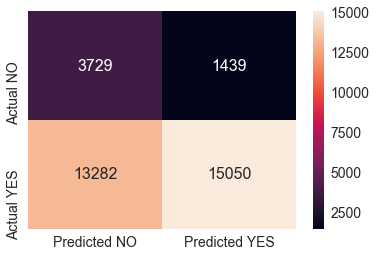

In [281]:
# confusion matrix heatmap for train data
cm_heatmap(cm_train_tfidf)

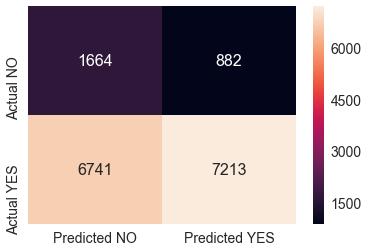

In [282]:
# confusion matrix heatmap for test data
cm_heatmap(cm_test_tfidf)

#### 2.2.6 Visualizing Decision tree with Graphviz

In [284]:
# Extracting all feature names from the vectorizers of respective features

tfidf_feature_names= f3+f4+f5+f6+f7+f8+f9
len(tfidf_feature_names)

7446

In [285]:
tfidf_feature_names.append('price')         #price, quantity & previously_posted_projects are numerical features
tfidf_feature_names.append('quantity')
tfidf_feature_names.append('teacher_number_of_previously_posted_projects')
len(tfidf_feature_names)

7449

In [286]:
import os
os.environ["PATH"] += os.pathsep + r'D:\PGS\Applied AI course\Assignments\Mandatory\graphviz'

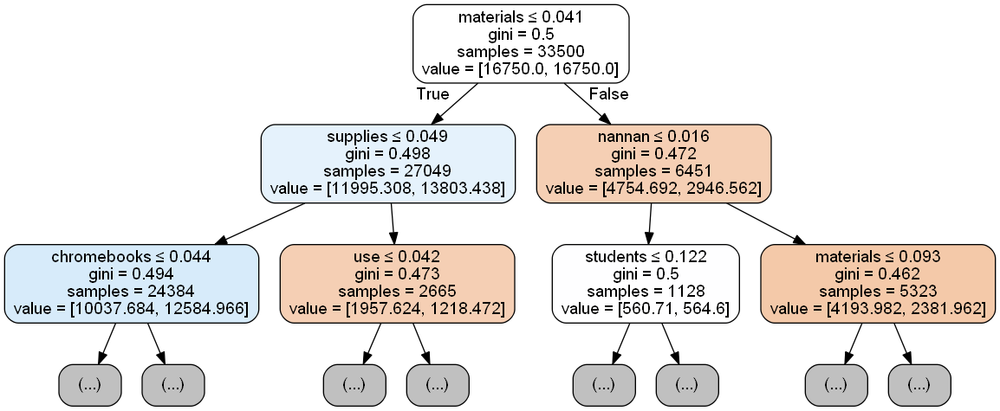

In [287]:
# Refernces:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://scikit-learn.org/stable/modules/generated/sklearn.tree.export_graphviz.html


from sklearn import tree
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO
from IPython.display import Image
import pydotplus
import collections

dot_data = StringIO()

viz2=export_graphviz(dt_best_tfidf,max_depth=2, out_file=dot_data, filled=True, rounded=True,special_characters=True,feature_names=tfidf_feature_names)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

#### 2.2.7 Analysis of False Positives

In [288]:
# Extracting false postives
FP_tfidf = []
for i in range(len(y_test)) :
    if (y_test[i] == 0) and (pred_labels_test[i] == 1) :
        FP_tfidf.append(i)
FP_essay_tfidf = []
for i in FP_tfidf :
    FP_essay_tfidf.append(X_test['preprocessed_essays'].values[i])

In [289]:
print(f'Total number of false positives = {len(FP_tfidf)}')

Total number of false positives = 1347


### Wordcloud

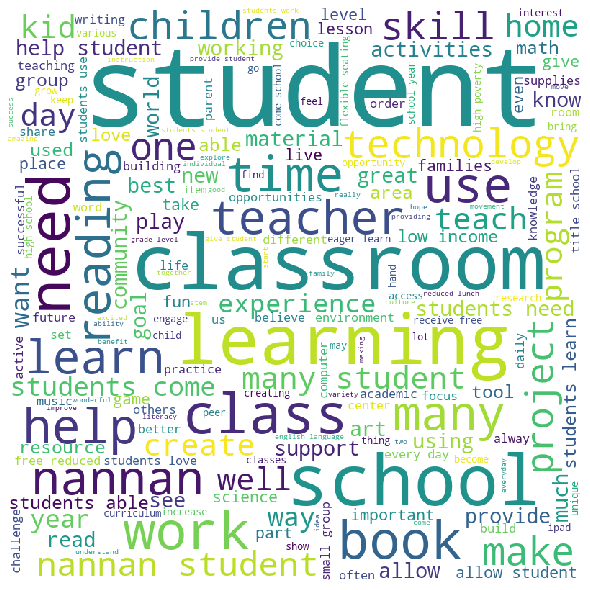

In [290]:
#plot the word cloud
#https://www.geeksforgeeks.org/generating-word-cloud-python/
from wordcloud import WordCloud

words = ' '
for row in FP_essay_tfidf:
    tokens = row.split()
    for t in tokens:
        words += t + ' '

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate(words)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()        


#### From the wordcloud above, it can be observed that the words " student", "classroom", "teacher" & "need" had a lot of impact in predicting the class label as 1 when it was supposed to be 0.

### Box plot on Price feature for false positives

In [291]:
FP_price_tfidf = []
FP_projects_tfidf=[]
for i in FP_tfidf :
    FP_price_tfidf.append(X_test['price'].values[i])
    FP_projects_tfidf.append(X_test['teacher_number_of_previously_posted_projects'].values[i])

In [292]:
df_tfidf=pd.DataFrame(columns=['Price','Projects'])
df_tfidf['Price']=FP_price_tfidf
df_tfidf['Projects']=FP_projects_tfidf
df_tfidf.head()

,Price,Projects
0,404.90,5
1,551.78,1
2,206.74,31
3,451.17,82
4,199.96,1


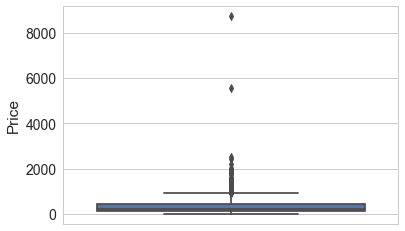

In [293]:
sns.set_style("whitegrid") 
  
sns.boxplot(y = 'Price', data = df_tfidf) 

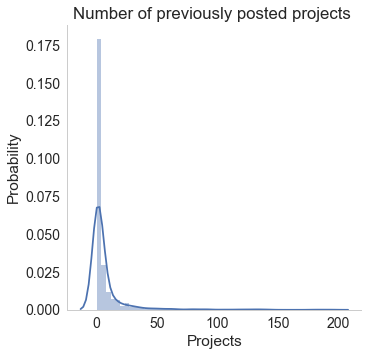

In [294]:
#pdf
import warnings 
warnings.filterwarnings("ignore")

sns.FacetGrid(df_tfidf,size=5) \
   .map(sns.distplot,'Projects') \
   .add_legend()
plt.ylabel('Probability')
plt.title("Number of previously posted projects ")
plt.grid()
plt.show()

### 2.3 Set 3: AvgW2V featurization

#### 2.3.1 Hyper parameter tuning

In [295]:
dt_avg = DecisionTreeClassifier(criterion='gini',class_weight = 'balanced') #https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
parameters = {'max_depth': [4, 6, 8, 10, 30,50], 'min_samples_split': [5, 20, 80, 200, 500, 800]}
clf3 = RandomizedSearchCV(dt_avg, parameters, cv=3, scoring='roc_auc',return_train_score=True,n_jobs=-1)
rs3 = clf3.fit(X_tr_avgw2v, y_train)

In [296]:
df2=pd.DataFrame(clf3.cv_results_)
df2.head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,11.961802,2.504694,0.069294,0.002054,80,4,"{'min_samples_split': 80, 'max_depth': 4}",0.607845,0.595941,0.587056,0.596948,0.008517,1,0.633428,0.644941,0.643454,0.640608,0.005113
1,38.023394,2.278792,0.092281,0.014258,20,10,"{'min_samples_split': 20, 'max_depth': 10}",0.549832,0.558050,0.556886,0.554923,0.003631,9,0.853421,0.864866,0.852361,0.856883,0.005661
2,10.855789,0.277335,0.072292,0.002493,5,4,"{'min_samples_split': 5, 'max_depth': 4}",0.607845,0.595941,0.587056,0.596948,0.008517,1,0.633428,0.644941,0.643454,0.640608,0.005113
3,19.719419,0.630861,0.085631,0.011540,800,50,"{'min_samples_split': 800, 'max_depth': 50}",0.603238,0.592600,0.588501,0.594780,0.006211,4,0.693741,0.709764,0.700657,0.701388,0.006562
4,25.071697,0.289909,0.088951,0.011218,500,50,"{'min_samples_split': 500, 'max_depth': 50}",0.589877,0.590682,0.577953,0.586171,0.005820,7,0.726670,0.738759,0.735334,0.733588,0.005088


#### 2.3.2 3D-Plot

In [297]:
# https://plot.ly/python/3d-axes/
trace1 = go.Scatter3d(x=df2['param_min_samples_split'],y=df2['param_max_depth'],z=df2['mean_train_score'], name = 'train')
trace2 = go.Scatter3d(x=df2['param_min_samples_split'],y=df2['param_max_depth'],z=df2['mean_test_score'], name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='Min_samples'),
        yaxis = dict(title='Max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

#### 2.3.3 Best Hyperparameters

In [308]:
print(clf3.best_estimator_)
print(f'Score on train data : {clf3.score(X_tr_avgw2v,y_train)}')
print(f'Mean cross-validated score of the best_estimator : {clf3.best_score_}')

DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=4,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=80,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')
Score on train data : 0.633075862648499
Mean cross-validated score of the best_estimator : 0.5969475086213375


In [305]:
best_parameters_tfidf = {'max_depth': [4], 'min_samples_split': [80]}

#### 2.3.4 Applying Best Hyperparameters on train & test data & plotting ROC curve

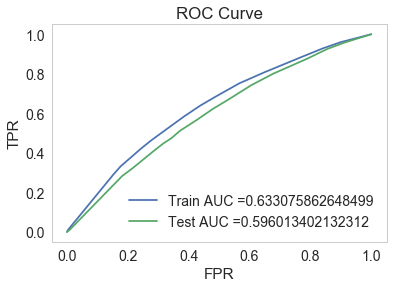

In [311]:
dt_best_avg= DecisionTreeClassifier (class_weight = 'balanced',max_depth=4,min_samples_split=80)

dt_best_avg.fit(X_tr_avgw2v, y_train)

y_train_pred_avg_best,pred_labels_train = batch_predict(dt_best_avg, X_tr_avgw2v)
y_test_pred_avg_best,pred_labels_test = batch_predict(dt_best_avg, X_test_avgw2v)

train_tpr_avg, train_fpr_avg, tr_thresholds_avg = roc_curve(y_train, y_train_pred_avg_best)
test_tpr_avg, test_fpr_avg, te_thresholds_avg = roc_curve(y_test, y_test_pred_avg_best)

plt.plot(train_tpr_avg, train_fpr_avg,label="Train AUC ="+str(auc(train_tpr_avg, train_fpr_avg)))
plt.plot(test_tpr_avg, test_fpr_avg, label="Test AUC ="+str(auc(test_tpr_avg, test_fpr_avg)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve")
plt.grid()
plt.show()

#### 2.3.5 Plot confusion matrix

In [312]:
from sklearn.metrics import confusion_matrix
best_t_avg = find_best_threshold(tr_thresholds_avg, train_fpr_avg, train_tpr_avg)
print("Train confusion matrix")
cm_train_avg=confusion_matrix(y_train, predict_with_best_t(y_train_pred_avg_best, best_t_avg))
print(cm_train_avg)
print("Test confusion matrix")
cm_test_avg=confusion_matrix(y_test, predict_with_best_t(y_test_pred_avg_best, best_t_avg))
print(cm_test_avg)

The maximum value of tpr*(1-fpr) 0.1600459216656635 for threshold 0.528
Train confusion matrix
[[ 3176  1992]
 [11764 16568]]
Test confusion matrix
[[1463 1083]
 [6068 7886]]


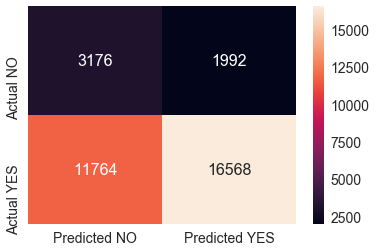

In [313]:
# confusion matrix heatmap for train data
cm_heatmap(cm_train_avg)

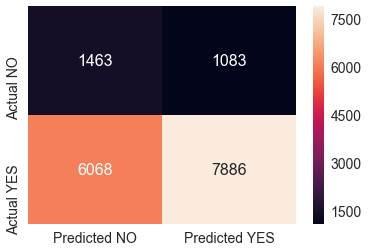

In [314]:
# confusion matrix heatmap for test data
cm_heatmap(cm_test_avg)

#### 2.3.7 Analysis of False Positives

In [315]:
# Extracting false postives
FP_avg = []
for i in range(len(y_test)) :
    if (y_test[i] == 0) and (pred_labels_test[i] == 1) :
        FP_avg.append(i)
FP_essay_avg = []
for i in FP_avg :
    FP_essay_avg.append(X_test['preprocessed_essays'].values[i])

In [316]:
print(f'Total number of false positives = {len(FP_avg)}')

Total number of false positives = 1220


### Wordcloud

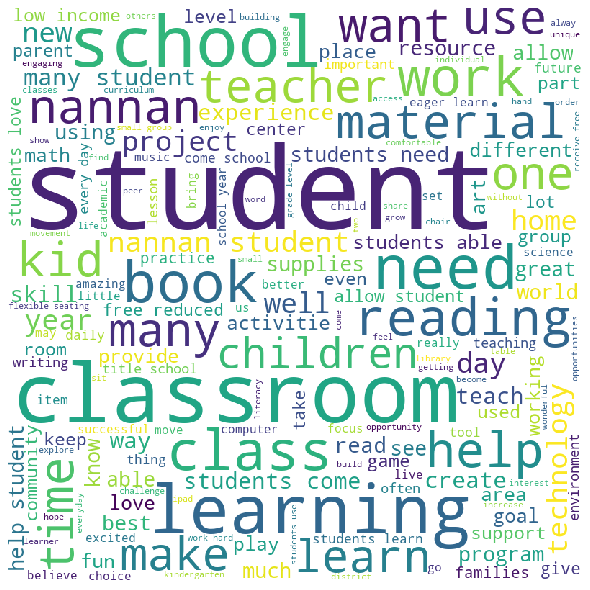

In [317]:
#plot the word cloud
#https://www.geeksforgeeks.org/generating-word-cloud-python/
from wordcloud import WordCloud

words = ' '
for row in FP_essay_avg:
    tokens = row.split()
    for t in tokens:
        words += t + ' '

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate(words)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()        


#### From the wordcloud above, it can be observed that the words " student", "school", "book" & "need" had a lot of impact in predicting the class label as 1 when it was supposed to be 0.

### Box plot on Price feature for false positives

In [318]:
FP_price_avg = []
FP_projects_avg=[]
for i in FP_avg :
    FP_price_avg.append(X_test['price'].values[i])
    FP_projects_avg.append(X_test['teacher_number_of_previously_posted_projects'].values[i])

In [319]:
df_avg=pd.DataFrame(columns=['Price','Projects'])
df_avg['Price']=FP_price_avg
df_avg['Projects']=FP_projects_avg
df_avg.head()

,Price,Projects
0,2020.93,27
1,315.37,0
2,133.49,0
3,199.96,1
4,359.96,3


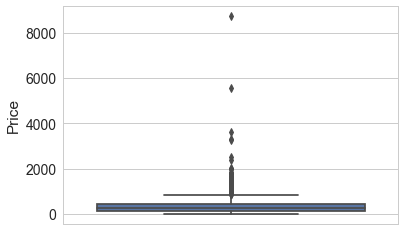

In [320]:
sns.set_style("whitegrid") 
  
sns.boxplot(y = 'Price', data = df_avg) 

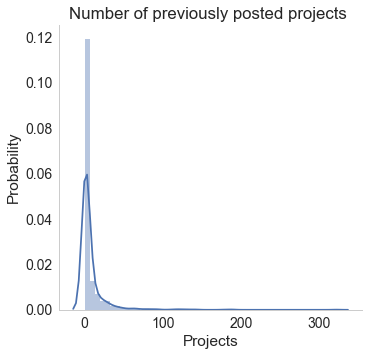

In [321]:
#pdf
import warnings 
warnings.filterwarnings("ignore")

sns.FacetGrid(df_avg,size=5) \
   .map(sns.distplot,'Projects') \
   .add_legend()
plt.ylabel('Probability')
plt.title("Number of previously posted projects ")
plt.grid()
plt.show()

### 2.4 Set 4: TFIDFW2V featurization

#### 2.4.1 Hyper parameter tuning

In [322]:
dt_tw = DecisionTreeClassifier(criterion='gini',class_weight = 'balanced') #https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
parameters = {'max_depth': [4, 6, 8, 10, 30, 50], 'min_samples_split': [5, 20, 80, 200, 500, 800]}
clf4 = RandomizedSearchCV(dt_tw, parameters, cv=3, scoring='roc_auc',return_train_score=True,n_jobs=-1)
rs4 = clf4.fit(X_tr_tfidf_w2v, y_train)

In [323]:
df3=pd.DataFrame(clf4.cv_results_)
df3.head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,43.771447,7.377569,2.570922,1.769419,500,50,"{'min_samples_split': 500, 'max_depth': 50}",0.577215,0.613083,0.585680,0.591993,0.015308,7,0.750697,0.749704,0.751986,0.750796,0.000934
1,43.209565,0.497868,0.357273,0.366711,5,8,"{'min_samples_split': 5, 'max_depth': 8}",0.564375,0.591502,0.582813,0.579563,0.011310,8,0.783954,0.777250,0.797359,0.786188,0.008360
2,35.242696,2.280972,0.092892,0.011800,500,30,"{'min_samples_split': 500, 'max_depth': 30}",0.577215,0.613551,0.585680,0.592149,0.015523,6,0.750697,0.749704,0.751986,0.750796,0.000934
3,24.975228,4.094482,0.115971,0.011310,500,6,"{'min_samples_split': 500, 'max_depth': 6}",0.611921,0.616117,0.594312,0.607450,0.009447,2,0.688299,0.688925,0.698231,0.691818,0.004542
4,28.721339,2.797737,0.125303,0.003770,800,30,"{'min_samples_split': 800, 'max_depth': 30}",0.587412,0.617895,0.593635,0.599647,0.013151,4,0.719710,0.715906,0.703456,0.713024,0.006941


#### 2.4.2 3D-Plot

In [324]:
# https://plot.ly/python/3d-axes/
trace1 = go.Scatter3d(x=df3['param_min_samples_split'],y=df3['param_max_depth'],z=df3['mean_train_score'], name = 'train')
trace2 = go.Scatter3d(x=df3['param_min_samples_split'],y=df3['param_max_depth'],z=df3['mean_test_score'], name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='Min_samples'),
        yaxis = dict(title='Max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

#### 2.4.3 Best Hyperparameters

In [326]:
print(clf4.best_estimator_)
print(f'Score on train data : {clf4.score(X_tr_tfidf_w2v,y_train)}')
print(f'Mean cross-validated score of the best_estimator : {clf4.best_score_}')

DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=4,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=800,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')
Score on train data : 0.6405634919151906
Mean cross-validated score of the best_estimator : 0.612679772013652


In [327]:
best_parameters_tfidf = {'max_depth': [4], 'min_samples_split': [800]}

#### 2.4.4 Applying Best Hyperparameters on train & test data & plotting ROC curve

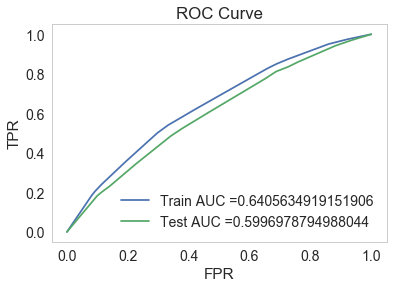

In [328]:
dt_best_tw= DecisionTreeClassifier (class_weight = 'balanced',max_depth=4,min_samples_split=800)

dt_best_tw.fit(X_tr_tfidf_w2v, y_train)

y_train_pred_tw_best,pred_labels_train = batch_predict(dt_best_tw, X_tr_tfidf_w2v)
y_test_pred_tw_best,pred_labels_test = batch_predict(dt_best_tw, X_test_tfidf_w2v)

train_tpr_tw, train_fpr_tw, tr_thresholds_tw = roc_curve(y_train, y_train_pred_tw_best)
test_tpr_tw, test_fpr_tw, te_thresholds_tw = roc_curve(y_test, y_test_pred_tw_best)

plt.plot(train_tpr_tw, train_fpr_tw,label="Train AUC ="+str(auc(train_tpr_tw, train_fpr_tw)))
plt.plot(test_tpr_tw, test_fpr_tw, label="Test AUC ="+str(auc(test_tpr_tw, test_fpr_tw)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve")
plt.grid()
plt.show()

#### 2.4.5 Plot confusion matrix

In [329]:
from sklearn.metrics import confusion_matrix
best_t_tw = find_best_threshold(tr_thresholds_tw, train_fpr_tw, train_tpr_tw)
print("Train confusion matrix")
cm_train_tw=confusion_matrix(y_train, predict_with_best_t(y_train_pred_tw_best, best_t_tw))
print(cm_train_tw)
print("Test confusion matrix")
cm_test_tw=confusion_matrix(y_test, predict_with_best_t(y_test_pred_tw_best, best_t_tw))
print(cm_test_tw)

The maximum value of tpr*(1-fpr) 0.1599966796834876 for threshold 0.474
Train confusion matrix
[[ 2979  2189]
 [10702 17630]]
Test confusion matrix
[[1348 1198]
 [5454 8500]]


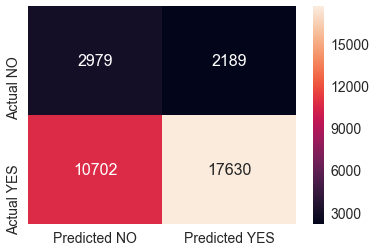

In [330]:
# confusion matrix heatmap for train data
cm_heatmap(cm_train_tw)

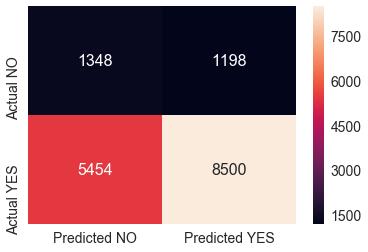

In [331]:
# confusion matrix heatmap for test data
cm_heatmap(cm_test_tw)

#### 2.4.6 Analysis of False Positives

In [332]:
# Extracting false postives
FP_tw = []
for i in range(len(y_test)) :
    if (y_test[i] == 0) and (pred_labels_test[i] == 1) :
        FP_tw.append(i)
FP_essay_tw = []
for i in FP_tw :
    FP_essay_tw.append(X_test['preprocessed_essays'].values[i])

In [333]:
print(f'Total number of false positives = {len(FP_tw)}')

Total number of false positives = 964


### Wordcloud

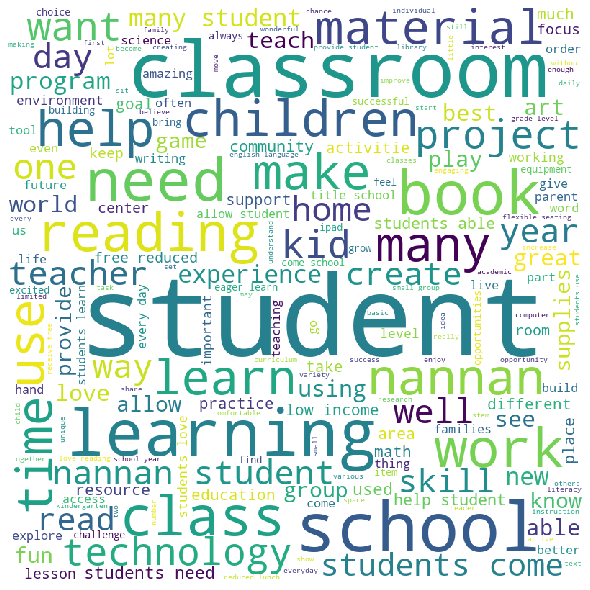

In [334]:
#plot the word cloud
#https://www.geeksforgeeks.org/generating-word-cloud-python/
from wordcloud import WordCloud

words = ' '
for row in FP_essay_tw:
    tokens = row.split()
    for t in tokens:
        words += t + ' '

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate(words)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()        


#### From the wordcloud above, it can be observed that the words " student", "school", "learning" & "classroom" had a lot of impact in predicting the class label as 1 when it was supposed to be 0.

### Box plot on Price feature for false positives

In [337]:
FP_price_tw = []
FP_projects_tw=[]
for i in FP_tw :
    FP_price_tw.append(X_test['price'].values[i])
    FP_projects_tw.append(X_test['teacher_number_of_previously_posted_projects'].values[i])

In [338]:
df_tw=pd.DataFrame(columns=['Price','Projects'])
df_tw['Price']=FP_price_tw
df_tw['Projects']=FP_projects_tw
df_tw.head()

,Price,Projects
0,2020.93,27
1,133.49,0
2,359.96,3
3,233.71,0
4,219.73,1


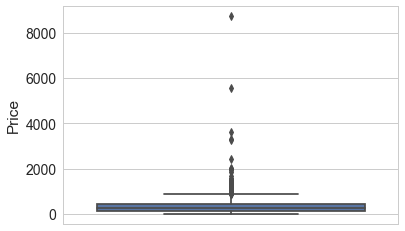

In [339]:
sns.set_style("whitegrid") 
  
sns.boxplot(y = 'Price', data = df_tw) 

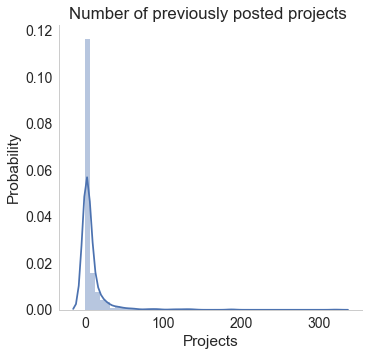

In [340]:
#pdf
import warnings 
warnings.filterwarnings("ignore")

sns.FacetGrid(df_tw,size=5) \
   .map(sns.distplot,'Projects') \
   .add_legend()
plt.ylabel('Probability')
plt.title("Number of previously posted projects ")
plt.grid()
plt.show()

### 2.5 Set 5: 5k best features from from features of Set 2.

In [366]:
# Using tfidf train & test to find top 5000 features
#clf2 corresponds to the randomsearchCV classifier that was used in set-2
X_train_5k = X_tr_tfidf[:,clf2.best_estimator_.feature_importances_.argsort()[::-1][:5000]]
X_test_5k = X_test_tfidf[:,clf2.best_estimator_.feature_importances_.argsort()[::-1][:5000]]

print(X_train_5k.shape)
print(X_test_5k.shape)

(33500, 5000)
(16500, 5000)


#### 2.5.1 Hyper parameter tuning

In [368]:
dt_5k = DecisionTreeClassifier(criterion='gini',class_weight = 'balanced') #https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
parameters = {'max_depth': [4, 6, 8, 10, 30, 50], 'min_samples_split': [5, 20, 80, 200, 500, 800]}
clf5 = RandomizedSearchCV(dt_5k, parameters, cv=3, scoring='roc_auc',return_train_score=True,n_jobs=-1)
rs5 = clf5.fit(X_train_5k, y_train)

In [369]:
df4=pd.DataFrame(clf5.cv_results_)
df4.head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples_split,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,mean_train_score,std_train_score
0,14.257821,0.458145,0.136588,0.023572,500,30,"{'min_samples_split': 500, 'max_depth': 30}",0.610756,0.580074,0.591748,0.594193,0.012645,5,0.775189,0.796327,0.788176,0.786564,0.008704
1,24.248760,1.046582,0.133592,0.012030,200,50,"{'min_samples_split': 200, 'max_depth': 50}",0.580697,0.566970,0.551462,0.566377,0.011942,9,0.869124,0.886457,0.910041,0.888541,0.016769
2,4.420130,0.068286,0.141919,0.008160,5,6,"{'min_samples_split': 5, 'max_depth': 6}",0.614629,0.610964,0.602106,0.609233,0.005257,3,0.655103,0.658708,0.669596,0.661135,0.006161
3,2.697118,0.022941,0.130926,0.014344,5,4,"{'min_samples_split': 5, 'max_depth': 4}",0.590296,0.599179,0.590848,0.593441,0.004064,6,0.608331,0.611864,0.630414,0.616870,0.009685
4,5.961580,0.079456,0.140254,0.015789,800,10,"{'min_samples_split': 800, 'max_depth': 10}",0.626899,0.609244,0.611511,0.615884,0.007843,1,0.686254,0.680482,0.681517,0.682751,0.002513


#### 2.5.2 3D-Plot

In [370]:
# https://plot.ly/python/3d-axes/
trace1 = go.Scatter3d(x=df4['param_min_samples_split'],y=df4['param_max_depth'],z=df4['mean_train_score'], name = 'train')
trace2 = go.Scatter3d(x=df4['param_min_samples_split'],y=df4['param_max_depth'],z=df4['mean_test_score'], name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='Min_samples'),
        yaxis = dict(title='Max_depth'),
        zaxis = dict(title='AUC'),))

fig = go.Figure(data=data, layout=layout)
offline.iplot(fig, filename='3d-scatter-colorscale')

#### 2.5.3 Best Hyperparameters

In [371]:
print(clf5.best_estimator_)
print(f'Score on train data : {clf5.score(X_train_5k,y_train)}')
print(f'Mean cross-validated score of the best_estimator : {clf5.best_score_}')

DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=10,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=800,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')
Score on train data : 0.68609838946892
Mean cross-validated score of the best_estimator : 0.6158844294289313


In [372]:
best_parameters_tfidf = {'max_depth': [10], 'min_samples_split': [800]}

#### 2.5.4 Applying Best Hyperparameters on train & test data & plotting ROC curve

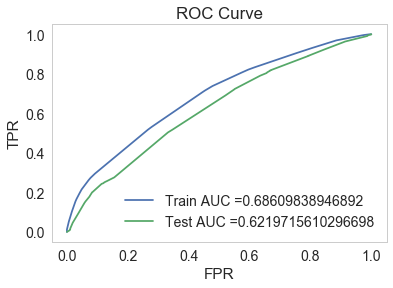

In [373]:
dt_best_5k= DecisionTreeClassifier (class_weight = 'balanced',max_depth=10,min_samples_split=800)

dt_best_5k.fit(X_train_5k, y_train)

y_train_pred_5k_best,pred_labels_train = batch_predict(dt_best_5k, X_train_5k)
y_test_pred_5k_best,pred_labels_test = batch_predict(dt_best_5k, X_test_5k)

train_tpr_5k, train_fpr_5k, tr_thresholds_5k = roc_curve(y_train, y_train_pred_5k_best)
test_tpr_5k, test_fpr_5k, te_thresholds_5k = roc_curve(y_test, y_test_pred_5k_best)

plt.plot(train_tpr_5k, train_fpr_5k,label="Train AUC ="+str(auc(train_tpr_5k, train_fpr_5k)))
plt.plot(test_tpr_5k, test_fpr_5k, label="Test AUC ="+str(auc(test_tpr_5k, test_fpr_5k)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve")
plt.grid()
plt.show()

#### 2.5.5 Plot confusion matrix

In [374]:
from sklearn.metrics import confusion_matrix
best_t_5k = find_best_threshold(tr_thresholds_5k, train_fpr_5k, train_tpr_5k)
print("Train confusion matrix")
cm_train_5k=confusion_matrix(y_train, predict_with_best_t(y_train_pred_5k_best, best_t_5k))
print(cm_train_5k)
print("Test confusion matrix")
cm_test_5k=confusion_matrix(y_test, predict_with_best_t(y_test_pred_5k_best, best_t_5k))
print(cm_test_5k)

The maximum value of tpr*(1-fpr) 0.1305342660816528 for threshold 0.534
Train confusion matrix
[[ 3729  1439]
 [13282 15050]]
Test confusion matrix
[[1664  882]
 [6740 7214]]


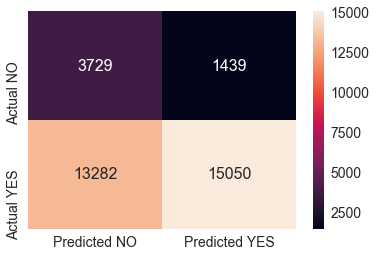

In [375]:
# confusion matrix heatmap for train data
cm_heatmap(cm_train_5k)

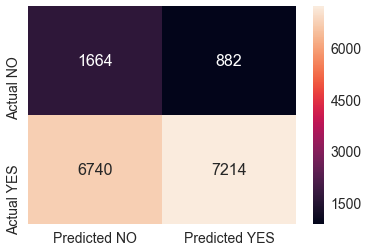

In [376]:
# confusion matrix heatmap for test data
cm_heatmap(cm_test_5k)

#### 2.5.6 Analysis of False Positives

In [377]:
# Extracting false postives
FP_5k = []
for i in range(len(y_test)) :
    if (y_test[i] == 0) and (pred_labels_test[i] == 1) :
        FP_5k.append(i)
FP_essay_5k = []
for i in FP_5k :
    FP_essay_5k.append(X_test['preprocessed_essays'].values[i])

In [378]:
print(f'Total number of false positives = {len(FP_5k)}')

Total number of false positives = 1347


### Wordcloud

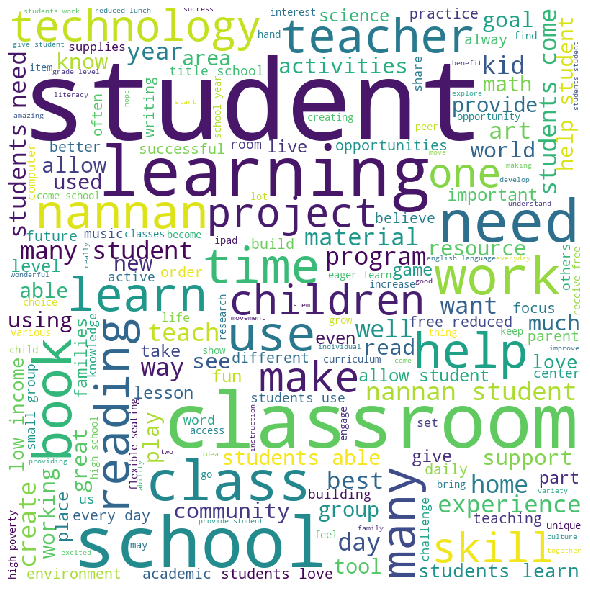

In [379]:
#plot the word cloud
#https://www.geeksforgeeks.org/generating-word-cloud-python/
from wordcloud import WordCloud

words = ' '
for row in FP_essay_5k:
    tokens = row.split()
    for t in tokens:
        words += t + ' '

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate(words)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()        


#### From the wordcloud above, it can be observed that the words " student", "school", "learning" & "classroom" had a lot of impact in predicting the class label as 1 when it was supposed to be 0.

### Box plot on Price feature for false positives

In [380]:
FP_price_5k = []
FP_projects_5k=[]
for i in FP_5k :
    FP_price_5k.append(X_test['price'].values[i])
    FP_projects_5k.append(X_test['teacher_number_of_previously_posted_projects'].values[i])

In [381]:
df_5k=pd.DataFrame(columns=['Price','Projects'])
df_5k['Price']=FP_price_5k
df_5k['Projects']=FP_projects_5k
df_5k.head()

,Price,Projects
0,404.90,5
1,551.78,1
2,206.74,31
3,451.17,82
4,199.96,1


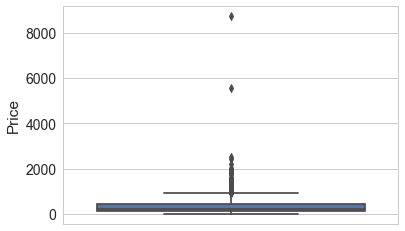

In [382]:
sns.set_style("whitegrid") 
  
sns.boxplot(y = 'Price', data = df_5k) 

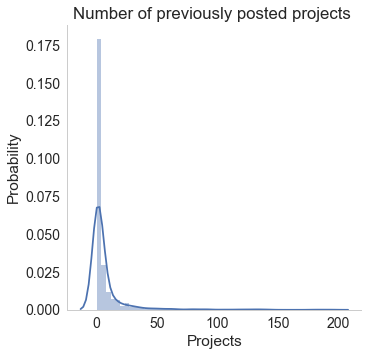

In [383]:
#pdf
import warnings 
warnings.filterwarnings("ignore")

sns.FacetGrid(df_5k,size=5) \
   .map(sns.distplot,'Projects') \
   .add_legend()
plt.ylabel('Probability')
plt.title("Number of previously posted projects ")
plt.grid()
plt.show()

## 3.0 Summary

In [385]:
#Ref: http://zetcode.com/python/prettytable/
from prettytable import PrettyTable
    
x = PrettyTable()
x.field_names = ["Vectorizer","max_depth","min_samples_split" ,"Test AUC"]
x.add_row(["BOW", 8, 500, 0.61])
x.add_row(["TFIDF", 10, 800, 0.62])
x.add_row(["Avg W2V", 4, 80, 0.60])
x.add_row(["TFIDF W2V", 4, 800, 0.60])
x.add_row(["TFIDF using 5K features", 10, 800, 0.62])

print(x)

+-------------------------+-----------+-------------------+----------+
|        Vectorizer       | max_depth | min_samples_split | Test AUC |
+-------------------------+-----------+-------------------+----------+
|           BOW           |     8     |        500        |   0.61   |
|          TFIDF          |     10    |        800        |   0.62   |
|         Avg W2V         |     4     |         80        |   0.6    |
|        TFIDF W2V        |     4     |        800        |   0.6    |
| TFIDF using 5K features |     10    |        800        |   0.62   |
+-------------------------+-----------+-------------------+----------+


- There was no change in performance when TFIDF with 5K features were used instead of all features. However, the time taken to fit the data with 5K features to a DT calssifier was marginally less compared to using all 7K features i.e. there was a difference of 15 seconds.